In [1]:
import os, re, pdb, json, itertools, re
import pandas as pd
import matplotlib.pyplot as plt
from natsort import natsorted 
import numpy as np

import time
import sys
sys.path.append('../')

# Plot All Results

In [2]:
def plot(df):
        
    if (not d):
        idx = 0
        axes[0, idx].set_title('No Daylighting', fontsize=20)
    if (d):
        idx = 1
        axes[0, idx].set_title('With Daylighting', fontsize=20)

    try:    
        df['rewards'].plot(ax=axes[0, idx])
        
        rps = re.findall("\d+\.\d+", fname)
        
        label = f"Power: {rps[0]}, Thermal: {rps[1]}, Vis: {rps[2]}"

        # HVAC
        if s == 'heating':
            df['hcoils'].plot(ax=axes[1, idx], label=label)
        if s == 'cooling':
            df['ccoils'].plot(ax=axes[1, idx], label=label)

        # PPD
        df['ppds'].plot(ax=axes[2, idx], label=label)

        # Illuminance
        df['illums'].plot(ax=axes[3, idx], label=label)
        axes[3, idx].set_xlabel('Iteration (Repeated Month)', fontsize=15);
        
        
    except ValueError:
        print('woops')

In [2]:
csvs = os.listdir('results')

# FORMATING = True
FORMATING = False

agents = ['DuelingDQN', 'SAC']
season = ['heating', 'cooling']
blinds = [True, False]
dlight = [True, False]

for a in agents:
    for s in season:
        for b in blinds:
            fig, axes = plt.subplots(4, 2, figsize=(20,30), sharex='col')
            if b:
                plt.suptitle(f'{a}, {s}, With Blinds', fontsize=35, y=0.97)
            else:
                plt.suptitle(f'{a}, {s}, No Blinds', fontsize=35, y=0.97)

            rows = ['Sum Reward', 'Sum Coil Power', 'Mean PPD', 'Illuminance\nViolation Rate']

            for ax, row in zip(axes[:,0], rows):
                ax.set_ylabel(row, rotation=90, fontsize=20)
                
            for d in dlight:
                fs = [i for i in csvs if ((s in i) and (a in i) and (f'blinds{b}' in i) and (f'dlighting{d}' in i))]
                if len(fs) == 0:
                    continue
                
                for fname in natsorted(fs):
                    pth = os.path.join('results', fname)
                    
                    with open(pth) as f:
                        df = pd.DataFrame(json.load(f))
                    lines, labels = fig.axes[-1].get_legend_handles_labels()
                    fig.legend(lines, labels, 
                               loc = 'lower center', ncol=4, 
                               fontsize=15, title_fontsize=20, 
                               title='Reward Constants', borderaxespad=12.)
                    fig.subplots_adjust(bottom=0.4)
                    
                    plot(df)
                    if FORMATING: break
                if FORMATING: break
            plt.savefig(f'convergence_{a}_{s}_blinds{b}.png')
            plt.show()
        if FORMATING: break
    if FORMATING: break

KeyboardInterrupt: 

# Clustering

## Plot By Multiplier

In [3]:
def load_baseline(pth):
    baseline = pd.read_csv(f'../baselines/{pth}.csv', index_col='time')

    if len(baseline) == 0:
        print('raising value error')
        raise ValueError()
        
    baseline.index = pd.to_datetime(baseline.index)

    if 'heating' in pth:
        baseline = baseline['1991-01-01 00:15:00':'1991-02-01 23:45:00']
    else:
        baseline = baseline['1991-07-01 00:15:00':'1991-08-02 00:00:00']
    
    if len(baseline) == 0:
        print('raising value error 2')
        raise ValueError()
    
    baseline_coil = baseline['Heat Coil Power'].sum() + baseline['Cool Coil Power'].sum()
    baseline_hvac = baseline['HVAC Power'].sum()
    
    comfort = baseline[baseline["Occupancy Flag"]==1].copy()
#     print('LEN', len(comfort))
    
    if len(comfort) == 0:
        print('raising value error 3')
        raise ValueError()
    
    baseline_ppd = comfort["PPD"].mean()
    illum_mean = ((comfort['Illuminance 1'] + comfort['Illuminance 2']) / 2).mean()
    ill = (comfort['Illuminance 1'] + comfort['Illuminance 2']) / 2
    try:
        illum_viol = len(ill[(ill < 300) | (ill > 750)]) / len(comfort)
    except ZeroDivisionError:
        pdb.set_trace()
        
    return baseline_coil, baseline_hvac, baseline_ppd, illum_viol



def plot(df):
        
    if rp == '0.1':
        idx = 0
    if rp == '0.4':
        idx = 1
    if rp == '0.7':
        idx = 2
    if rp == '1.0':
        idx = 3

    axes[0, idx].set_title(f'Power Mult: {rp}', fontsize=20)

    try:    
        df['rewards'].plot(ax=axes[0, idx])

        # HVAC
        if s == 'heating':
            df['hcoils'].plot(ax=axes[1, idx])
        if s == 'cooling':
            df['ccoils'].plot(ax=axes[1, idx])

        # PPD
        df['ppds'].plot(ax=axes[2, idx])

        # Illuminance
        df['illums'].plot(ax=axes[3, idx])
        axes[3, idx].set_xlabel('Iteration (Repeated Month)', fontsize=15);
        
        # Baselines
        axes[1, idx].hlines(baseline_coil, 0, len(df), color='black', linewidth=3,
                       linestyle=':', label='Baseline Result from P-controller')
        axes[2, idx].hlines(baseline_ppd, 0, len(df), color='black', linewidth=3,
                       linestyle=':', label='Baseline Result from P-controller')
        axes[3, idx].hlines(baseline_illum, 0, len(df), color='black', linewidth=3,
                       linestyle=':', label='Baseline Result from P-controller')
    except ValueError:
        print('woops')
    
    
def prep_plot_outer():    
    fig, axes = plt.subplots(4, 4, figsize=(20,20), sharex='col', sharey='row')

    rows = ['Sum Reward', 'Sum Coil Power', 'Mean PPD', 'Illuminance\nViolation Rate']

    for ax, row in zip(axes[:,0], rows):
        ax.set_ylabel(row, rotation=90, fontsize=20)
        
    return fig, axes
    
def prep_plot_inner():
    plt.suptitle(f'{a}, {s}, Blinds: {b}, Daylighting: {d}, {rp_name}', fontsize=35, y=0.97)

    for fname in natsorted(fs):
        file_rps = re.findall("\d+\.\d+", fname)
        if file_rps[rp_idx] == rp:
            pth = os.path.join('results', fname)

            with open(pth) as f:
                df = pd.DataFrame(json.load(f))

            plot(df)

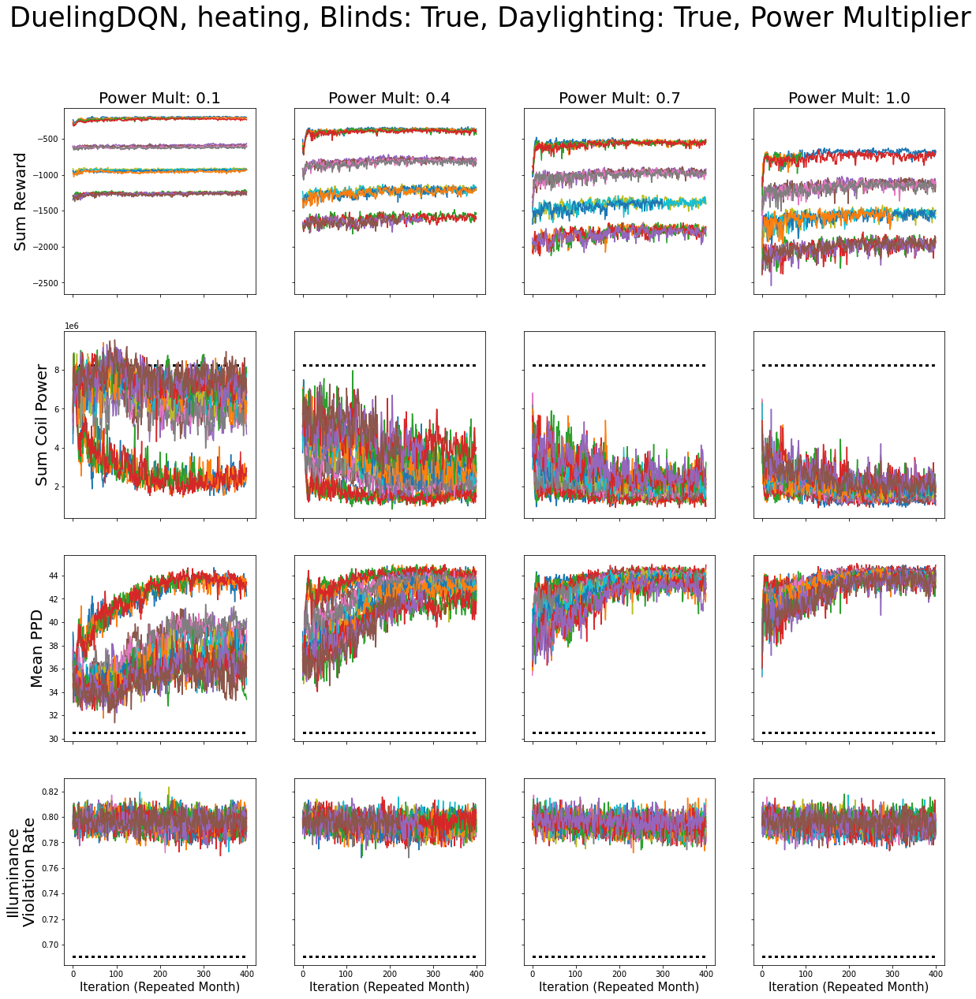

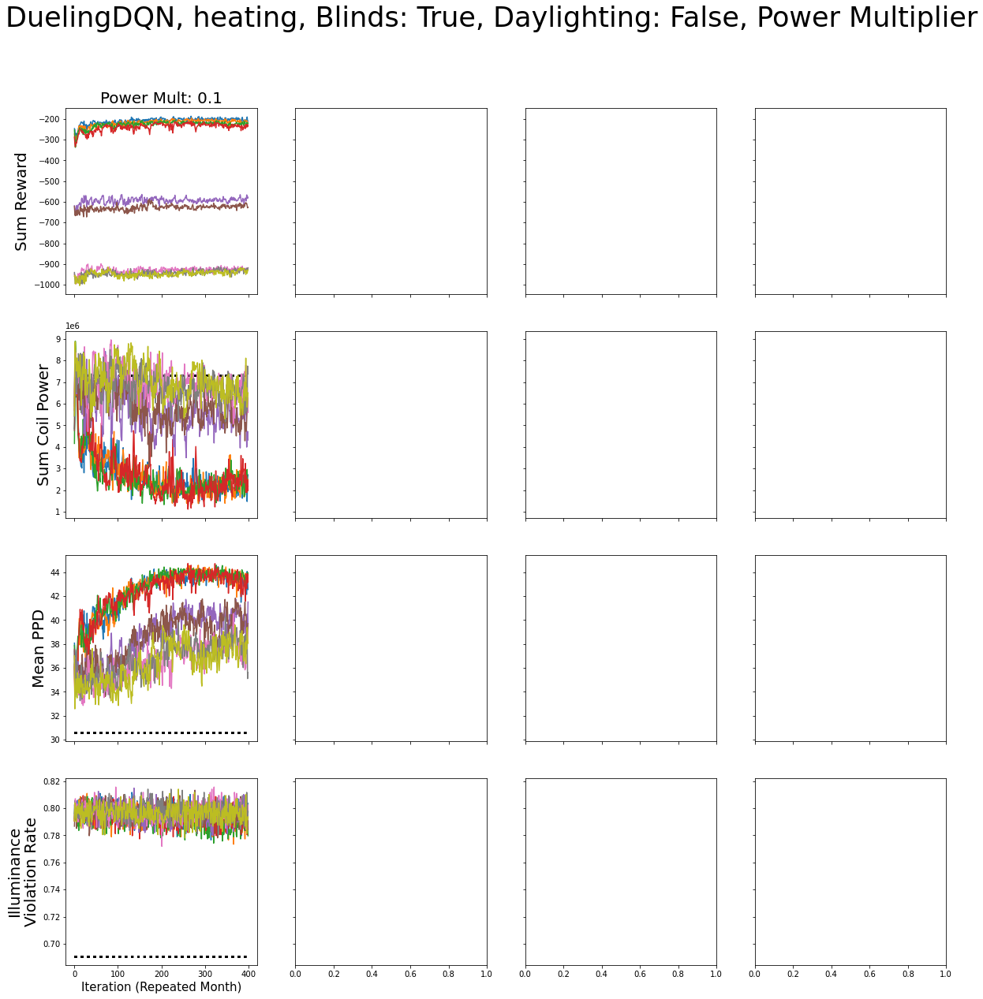

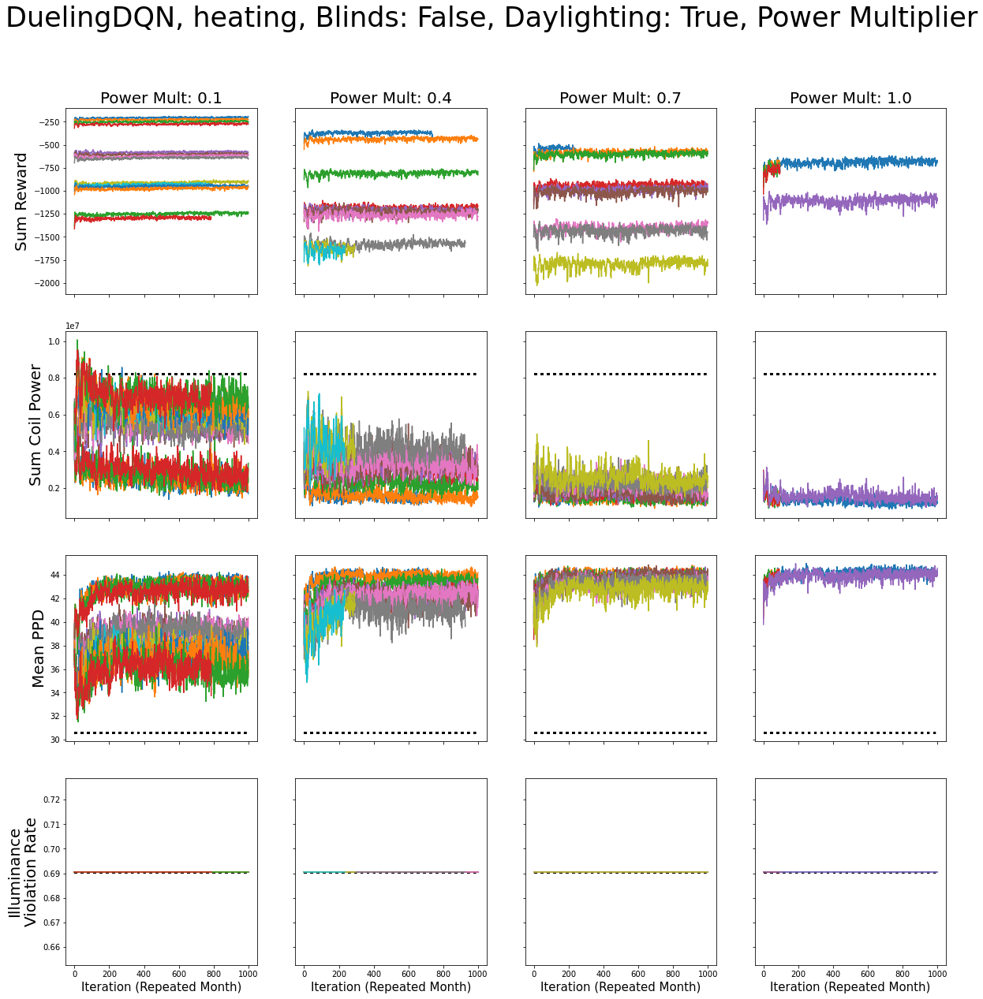

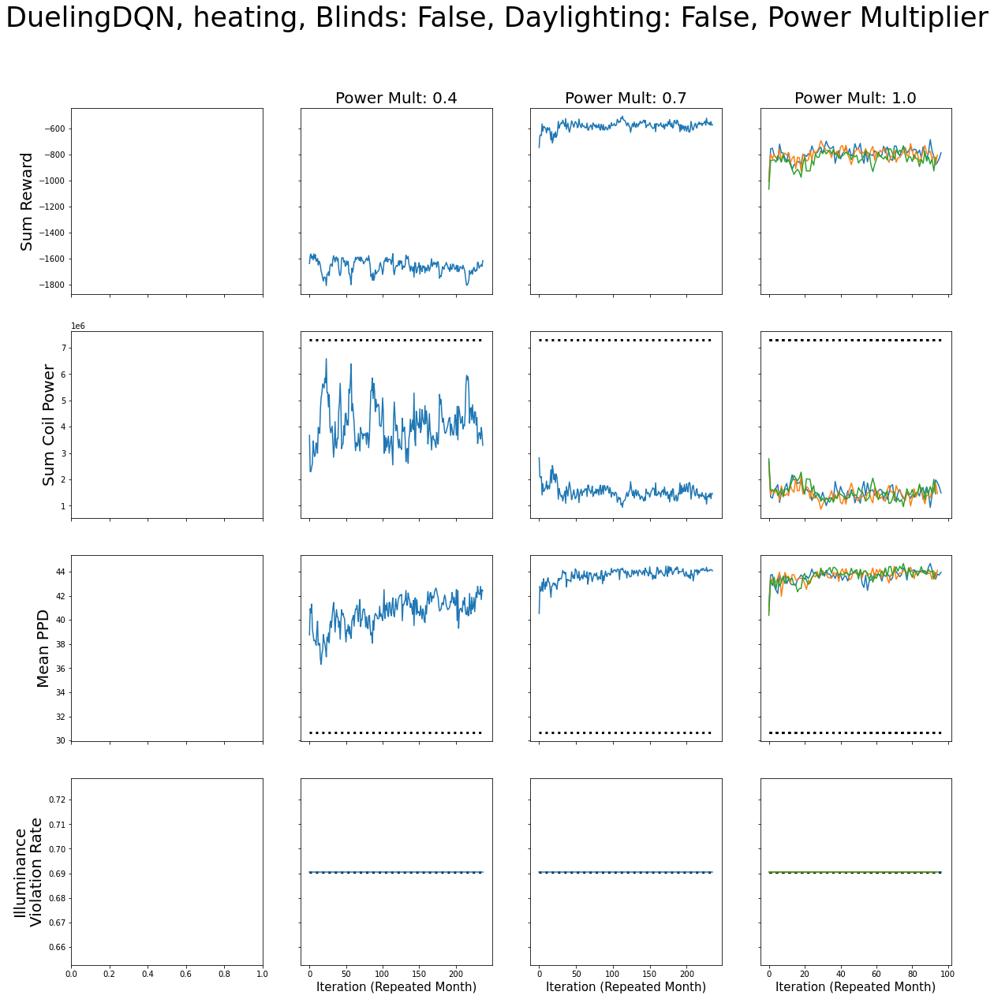

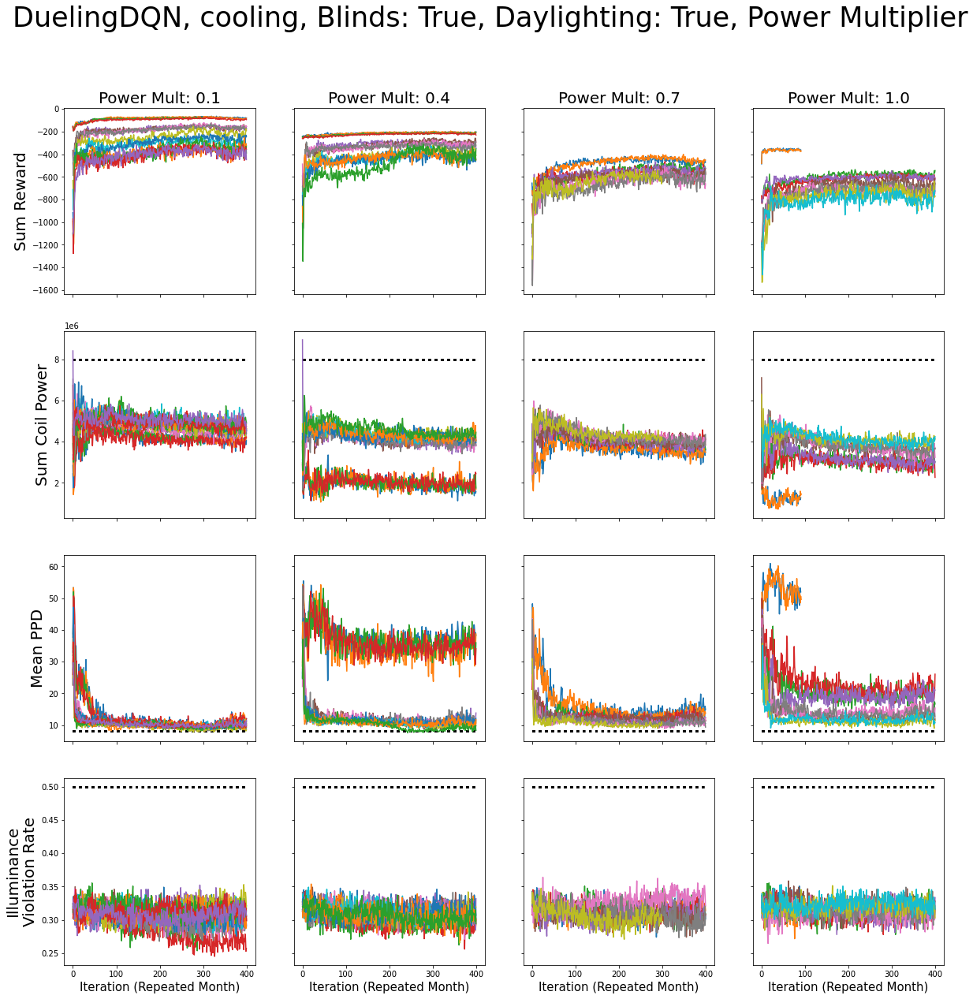

...

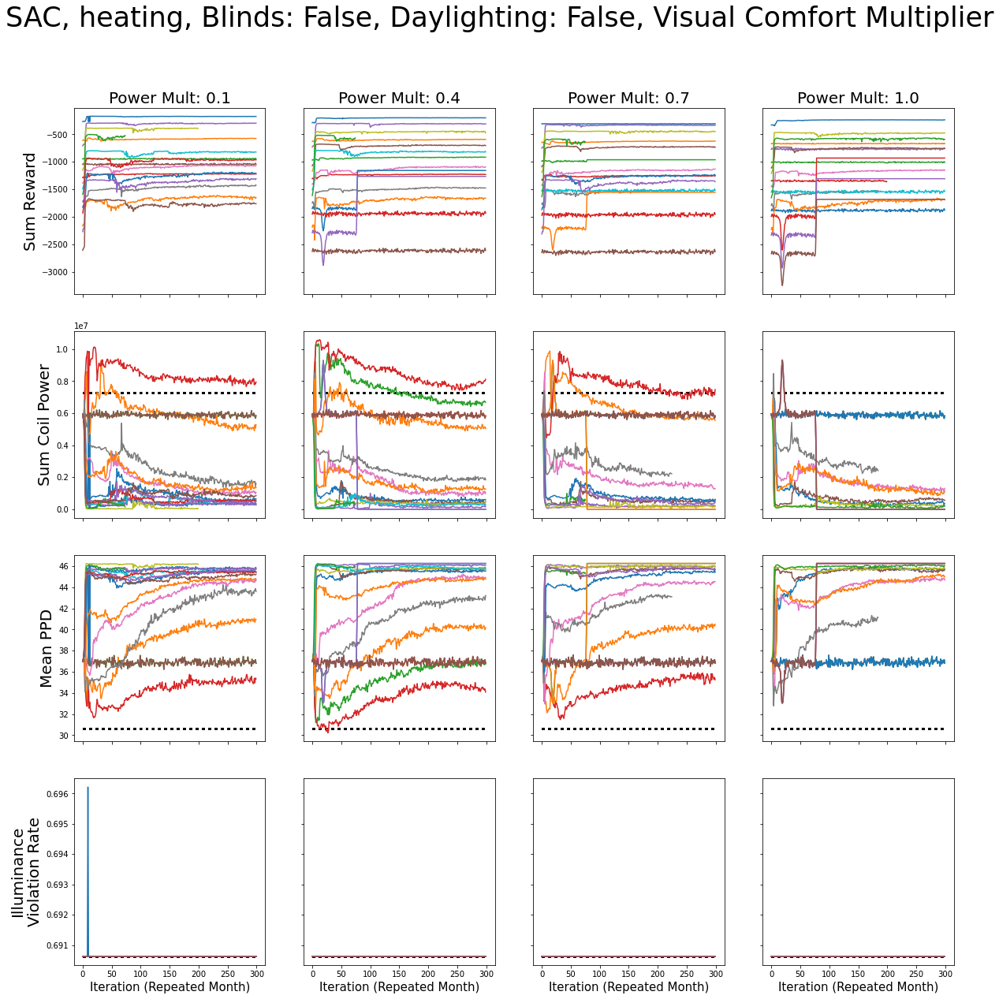

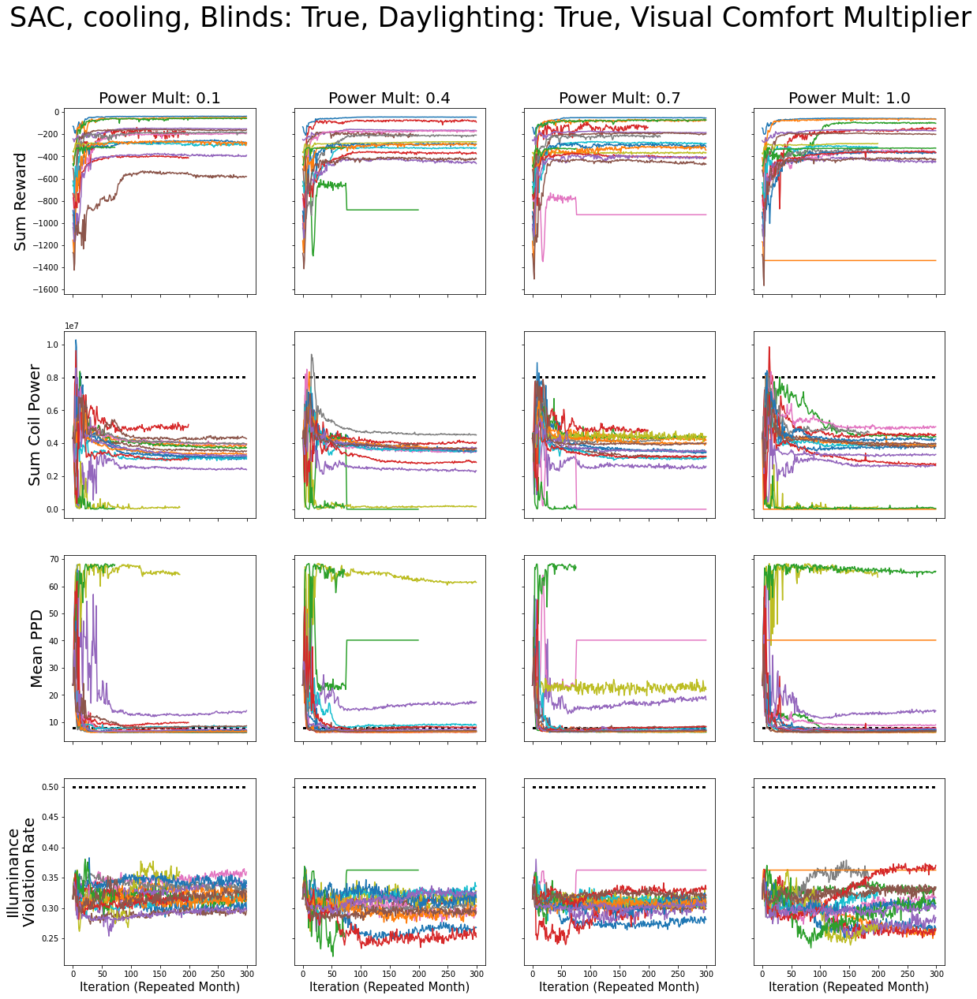

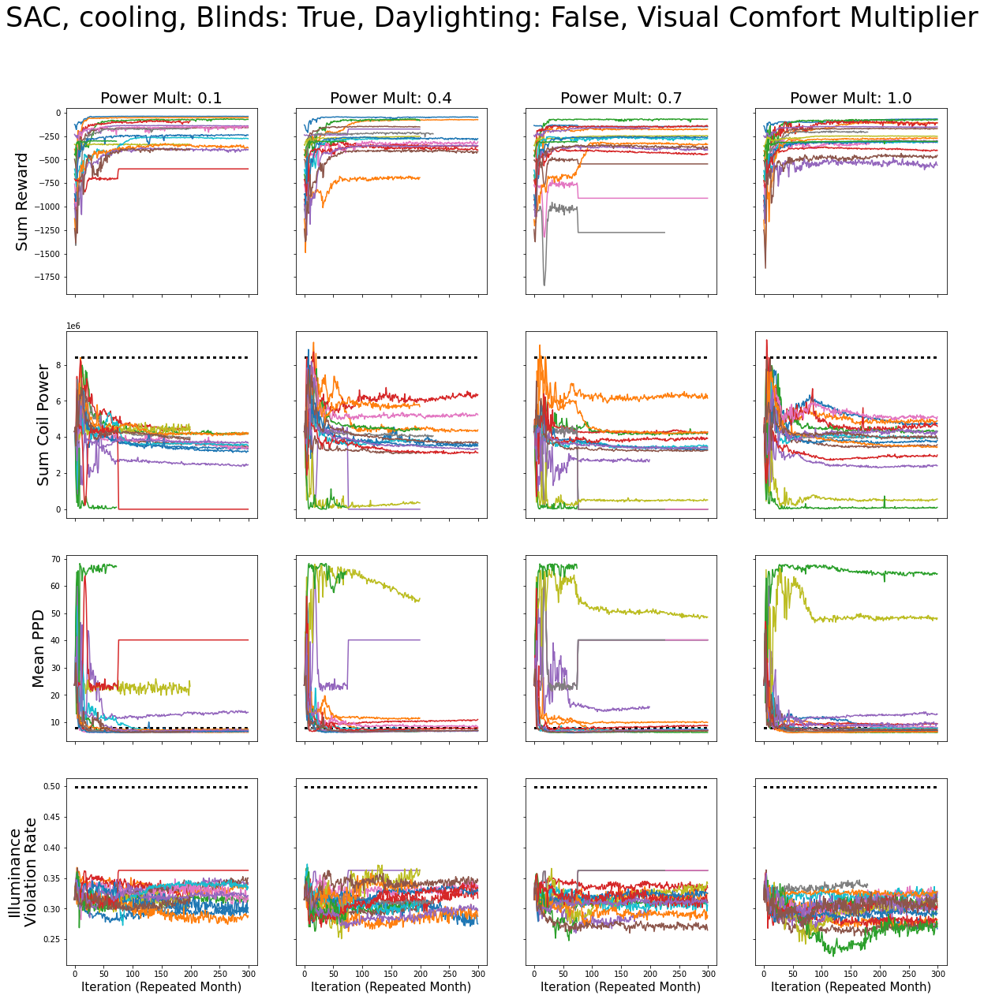

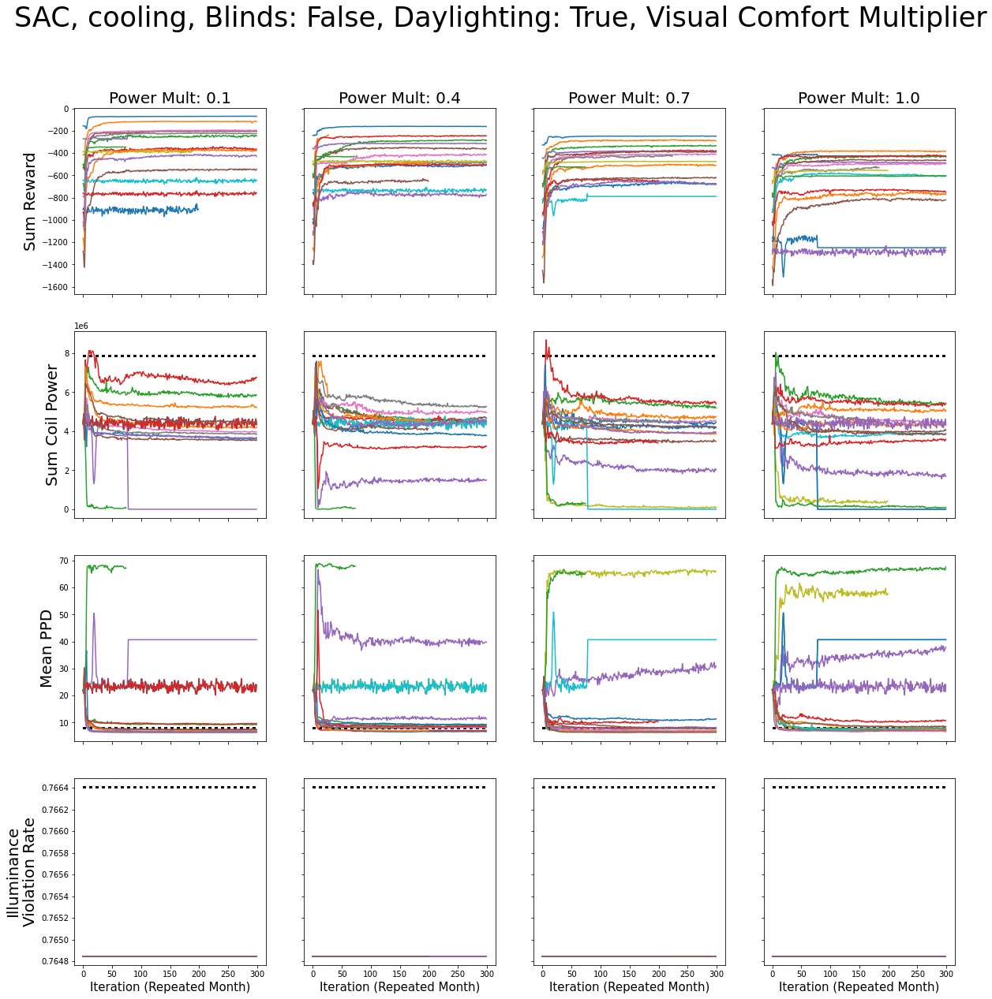

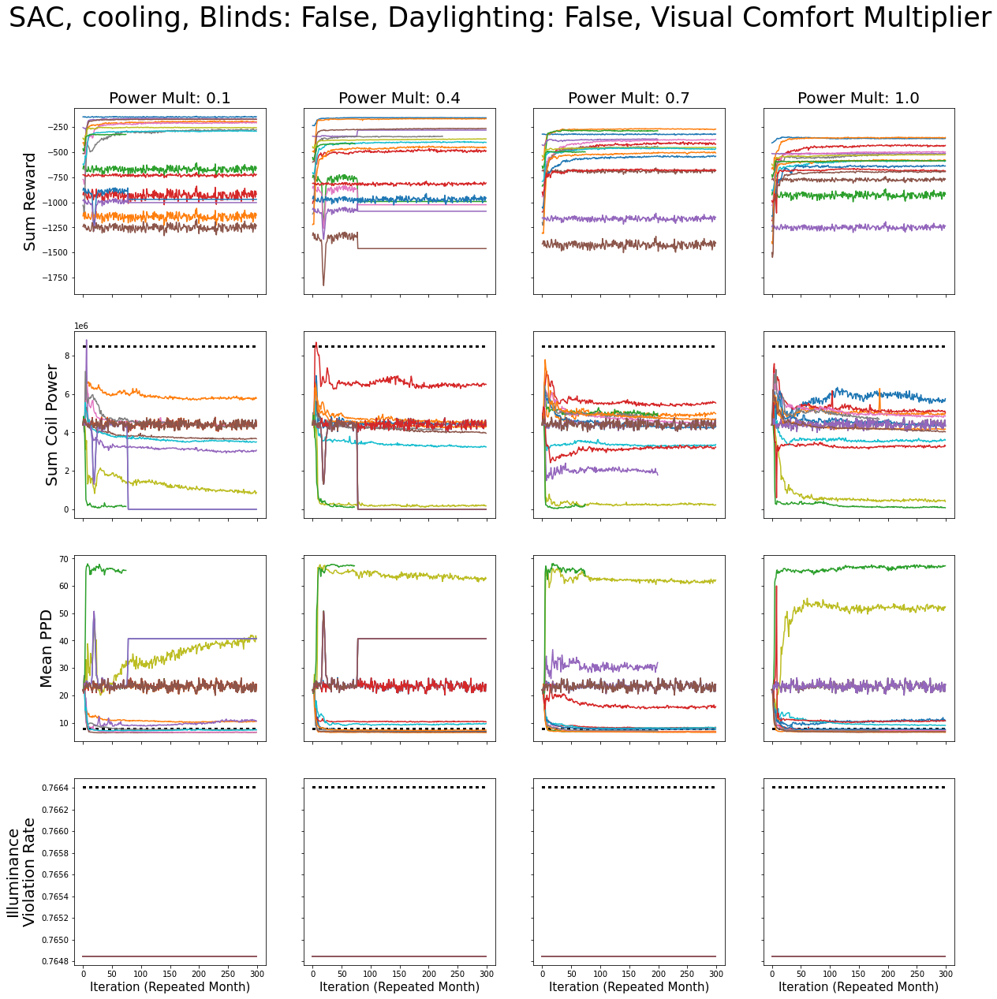

In [5]:
csvs = os.listdir('results')


agents = ['DuelingDQN', 'SAC']
season = ['heating', 'cooling']
blinds = [True, False]
dlight = [True, False]

reward_mult = {
    'Power Multiplier': 0,
    'Thermal Comfort Multiplier': 1,
    'Visual Comfort Multiplier': 2
}

for rp_name, rp_idx in reward_mult.items():
    for a in agents:
        for s in season:
            for b in blinds:
                for d in dlight:
                    fig, axes = prep_plot_outer()
                    fbase = f'{s}_blinds{b}_daylighting{d}'
                    baseline_coil, baseline_hvac, baseline_ppd, baseline_illum = load_baseline(fbase)

                    fs = [i for i in csvs if ((s in i) and (a in i) and (f'blinds{b}' in i) and (f'dlighting{d}' in i))]
                    if len(fs) == 0:
                        continue

                    for rp in ['0.1','0.4', '0.7', '1.0']:
                        prep_plot_inner()

                    plt.savefig(f"{rp_name}_convergence_{a}_{s}_blinds{b}_daylighting{d}.png")
                    plt.show()

## K-Means

In [21]:
# from scipy.cluster.vq import kmeans,vq,whiten

# param_list = list(itertools.product(seasons, blinds, daylighting, rp1s, rp2s, rp3s))


# arr = [0.1, 0.4, 0.7, 1]
# data = [arr, arr, arr]

# param_list = list(itertools.product(arr, arr, arr))

# data = whiten(√)

# centroids,_ = kmeans(data,4)

# print(centroids)

# # assign each sample to a cluster
# clx,_ = vq(data,centroids)

# # check clusters of observation
# print(clx)

# clusters = {
#     0: [], 1: [], 2: [], 3: []
# }
# len(param_list), len(clx)

# for p, idx in zip(param_list, clx):
#     clusters[idx].append(p)
    
# clusters